<a href="https://colab.research.google.com/github/FrancisRodr0010/ProyectoIA_SP1/blob/main/ProyectoIA_SP1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Proyecto SP1 - Inteligencia Artificial
Francisco Rodríguez - 22001828

Douglas Pérez - 22003865

Isabel Páiz - 22001411

# 1) Introducción

En este espacio vamos a resolver un problema de inteligencia artificial. En nuestro caso se nos dió un problema de clasificación, cuyo data set está especializado en cartas de 'Magic: The Gathering'. El problema que vamos a resolver es predecir el tipo (rarity) de la tarjeta en base a sus especialidades y features.

NOTA: El dataset se encuentra en el siguiente enlance:
https://www.kaggle.com/datasets/darrylljk/magic-the-gathering-card-ratings-otj

# 2) Preparación y **Librerias**

In [1]:

import tensorflow as tf

import matplotlib.pyplot as plt
from tensorflow.math import confusion_matrix


import pandas as pd
from sklearn.model_selection import train_test_split
import numpy as np

import seaborn as sns


import os

AUTOTUNE = tf.data.AUTOTUNE

# 3) Arquitectura #1

Para esta arquitectura haremos lo siguiente:

- Quitar valores nulos
- Aplicar Normalización min-max
- Descartar el campo nombre
- Usar earlystopping
- Función de activación Leaky ReLU

##3.1 Extracción de la data

In [2]:
#extracting the data

raw_data_arch1 = pd.read_csv("MTG-OTJ-draft-card-ratings-2024-05-25.csv")

raw_data_arch1.head()

,Name,Color,Rarity,# Seen,ALSA,# Picked,ATA,# GP,% GP,GP WR,# OH,OH WR,# GD,GD WR,# GIH,GIH WR,# GNS,GNS WR,IWD
0,Another Round,W,R,64972,6.27,7953,9.59,1690,3.6%,46.6%,259,NaN,402,NaN,661,40.4%,1029,50.6%,-10.2pp
1,Archangel of Tithes,W,M,9905,2.08,3697,2.15,18171,82.7%,53.9%,2952,54.6%,4325,55.8%,7277,55.3%,10927,52.9%,2.4pp
2,Armored Armadillo,W,C,378941,7.89,40803,11.61,31423,12.9%,51.0%,5421,50.0%,7265,50.8%,12686,50.4%,18704,51.3%,-0.9pp
3,Aven Interrupter,W,R,24080,2.42,8609,2.64,44852,86.6%,55.5%,7735,56.6%,10692,57.5%,18427,57.1%,26391,54.3%,2.8pp
4,Bounding Felidar,W,U,98493,4.11,18079,5.53,86683,80.2%,54.6%,13034,53.6%,20093,55.4%,33127,54.7%,52462,54.4%,0.3pp


##3.2 Pre-procesar la data

### 3.2.1 Quitando valores Nulos
Dentro de este dataset hay features que contienen valores nulos, como color, GP WR, ATA, OH WR, GD WR, GIH WR, GNS WR, y IWD

In [3]:
no_null_dataset = raw_data_arch1.copy()


print(no_null_dataset.isna().sum())

Name         0
Color       46
Rarity       0
# Seen       0
ALSA         0
# Picked     0
ATA          1
# GP         0
% GP         0
GP WR        8
# OH         0
OH WR       31
# GD         0
GD WR       23
# GIH        0
GIH WR      16
# GNS        0
GNS WR      12
IWD         16
dtype: int64


**Notar que hay varios valores nulos dentro del dataset. Hay que tener cuidado de que no vayamos a quitar demasiada información para luego poder entrenar el modelo con datos suficientes.**

In [4]:

no_null_dataset = no_null_dataset.dropna()

no_null_dataset.head()

,Name,Color,Rarity,# Seen,ALSA,# Picked,ATA,# GP,% GP,GP WR,# OH,OH WR,# GD,GD WR,# GIH,GIH WR,# GNS,GNS WR,IWD
1,Archangel of Tithes,W,M,9905,2.08,3697,2.15,18171,82.7%,53.9%,2952,54.6%,4325,55.8%,7277,55.3%,10927,52.9%,2.4pp
2,Armored Armadillo,W,C,378941,7.89,40803,11.61,31423,12.9%,51.0%,5421,50.0%,7265,50.8%,12686,50.4%,18704,51.3%,-0.9pp
3,Aven Interrupter,W,R,24080,2.42,8609,2.64,44852,86.6%,55.5%,7735,56.6%,10692,57.5%,18427,57.1%,26391,54.3%,2.8pp
4,Bounding Felidar,W,U,98493,4.11,18079,5.53,86683,80.2%,54.6%,13034,53.6%,20093,55.4%,33127,54.7%,52462,54.4%,0.3pp
5,Bovine Intervention,W,U,136473,6.33,12508,9.99,18372,24.9%,50.7%,2815,46.7%,4488,51.0%,7303,49.4%,11046,51.6%,-2.3pp


### 3.2.2 Parseando porcentajes
**Hay algunos features que son de tipo object, las cuales representan porsentajes de distintos modos de juego. Vamos a aplicar una función que lo que hace es pasar de porcentaje a valor decimal entre 0 y 1. Por ejemplo 32.1% se convierte a 0.321**

In [5]:


def parse_percentage(percentage_string):

  try:
    # Remove the "%" symbol and convert to a float.
    percentage_value = float(percentage_string[:-1])

    # Convert the percentage to a value between 0 and 1.
    return percentage_value / 100


  except (ValueError, IndexError):
    return None


**Dentro de la columna de IWD lo que vamos a hacer es deshacernos del texto del final (e.g -1.4pp, 4.2pp, 3.2pp, etc.)**

In [6]:
def parse_IWD(IWD_string):

  try:

    IWD_value = float(IWD_string[:-2])


    return IWD_value

  except (ValueError, IndexError):
    return None

### 3.2.3 Rarity - Ordinal Encoding
La rareza es nuesto target en este problema. Dentro de este campo podemos apreciar que existe una relación de orden en las cartas. Las rarezas son: Mythic, Rare, Uncommon, Common. Dentro del juego, las cartas con más valor y mejor impacto del juego son las cartas Mythic, luego les siguen las cartas Rare, que son buenas como las Mythic pero con un impacto un poco mas leve. Luego les sigue las cartas uncommon y luego las cartas common.

In [7]:
#unique values for rarity

no_null_dataset['Rarity'].unique()

array(['M', 'C', 'R', 'U'], dtype=object)

In [8]:
# M -> Mythic
# R -> Rare
# U -> Uncommon
# C -> Common


def parse_rarity(rarity_string):

  if rarity_string == 'M':
    return 0
  elif rarity_string == 'R':
    return 1
  elif rarity_string == 'U':
    return 2
  elif rarity_string == 'C':
    return 3
  else:
    return None

  return None



### 3.2.4 Color - One Hot Encoding
Vamos a aplicar One Hot enconding al campo de Color, porque existe una cantidad considerable de colores distintos de las cartas, y no se ve que tengan una relación en sí. Por ello vamos a aplicar este método.

In [9]:
no_null_dataset['Color'].unique()

array(['W', 'U', 'B', 'R', 'G', 'BR', 'WRG', 'WU', 'BG', 'WB', 'UG', 'UR',
       'WR', 'RG', 'WG', 'WUB', 'UB', 'WUG', 'UBR', 'URG', 'WBG', 'UBG'],
      dtype=object)

In [10]:
#applying one hot encoding to the Color column

no_null_dataset = pd.get_dummies(no_null_dataset, columns=['Color'])
no_null_dataset.head()

,Name,Rarity,# Seen,ALSA,# Picked,ATA,# GP,% GP,GP WR,# OH,...,Color_URG,Color_W,Color_WB,Color_WBG,Color_WG,Color_WR,Color_WRG,Color_WU,Color_WUB,Color_WUG
1,Archangel of Tithes,M,9905,2.08,3697,2.15,18171,82.7%,53.9%,2952,...,False,True,False,False,False,False,False,False,False,False
2,Armored Armadillo,C,378941,7.89,40803,11.61,31423,12.9%,51.0%,5421,...,False,True,False,False,False,False,False,False,False,False
3,Aven Interrupter,R,24080,2.42,8609,2.64,44852,86.6%,55.5%,7735,...,False,True,False,False,False,False,False,False,False,False
4,Bounding Felidar,U,98493,4.11,18079,5.53,86683,80.2%,54.6%,13034,...,False,True,False,False,False,False,False,False,False,False
5,Bovine Intervention,U,136473,6.33,12508,9.99,18372,24.9%,50.7%,2815,...,False,True,False,False,False,False,False,False,False,False


In [11]:

one_hot_dataset = no_null_dataset.copy()
one_hot_dataset.head()

,Name,Rarity,# Seen,ALSA,# Picked,ATA,# GP,% GP,GP WR,# OH,...,Color_URG,Color_W,Color_WB,Color_WBG,Color_WG,Color_WR,Color_WRG,Color_WU,Color_WUB,Color_WUG
1,Archangel of Tithes,M,9905,2.08,3697,2.15,18171,82.7%,53.9%,2952,...,False,True,False,False,False,False,False,False,False,False
2,Armored Armadillo,C,378941,7.89,40803,11.61,31423,12.9%,51.0%,5421,...,False,True,False,False,False,False,False,False,False,False
3,Aven Interrupter,R,24080,2.42,8609,2.64,44852,86.6%,55.5%,7735,...,False,True,False,False,False,False,False,False,False,False
4,Bounding Felidar,U,98493,4.11,18079,5.53,86683,80.2%,54.6%,13034,...,False,True,False,False,False,False,False,False,False,False
5,Bovine Intervention,U,136473,6.33,12508,9.99,18372,24.9%,50.7%,2815,...,False,True,False,False,False,False,False,False,False,False


In [12]:
def boolean_to_int(value):
  if value == True:
    return 1
  elif value == False:
    return 0
  else:
    return None


In [13]:
one_hot_dataset.columns

Index(['Name', 'Rarity', '# Seen', 'ALSA', '# Picked', 'ATA', '# GP', '% GP',
       'GP WR', '# OH', 'OH WR', '# GD', 'GD WR', '# GIH', 'GIH WR', '# GNS',
       'GNS WR', 'IWD', 'Color_B', 'Color_BG', 'Color_BR', 'Color_G',
       'Color_R', 'Color_RG', 'Color_U', 'Color_UB', 'Color_UBG', 'Color_UBR',
       'Color_UG', 'Color_UR', 'Color_URG', 'Color_W', 'Color_WB', 'Color_WBG',
       'Color_WG', 'Color_WR', 'Color_WRG', 'Color_WU', 'Color_WUB',
       'Color_WUG'],
      dtype='object')

**Ahora vamos a aplicar todas las funciones definidas a los campos que son Categóricos, y así dejar como resultado únicamente valores numéricos**

In [14]:
#apply the previous function to the new columns that were created in the getdummies step
""" array(['W', 'U', 'B', 'R', 'G', 'BR', 'WRG', 'WU', 'BG', 'WB', 'UG', 'UR',
       'WR', 'RG', 'WG', 'WUB', 'UB', 'WUG', 'UBR', 'URG', 'WBG', 'UBG'],
      dtype=object)
      """



for column in one_hot_dataset.columns:

  if column.startswith('Color_'):
    one_hot_dataset[column] = one_hot_dataset[column].apply(boolean_to_int)


for i in ['% GP', 'GP WR', 'OH WR', 'GD WR', 'GIH WR', 'GNS WR']:
  one_hot_dataset[i] = one_hot_dataset[i].apply(parse_percentage)

one_hot_dataset['Rarity'] = one_hot_dataset['Rarity'].apply(parse_rarity)

one_hot_dataset['IWD'] = one_hot_dataset['IWD'].apply(parse_IWD)

parsed_dataset = one_hot_dataset.copy()
parsed_dataset

,Name,Rarity,# Seen,ALSA,# Picked,ATA,# GP,% GP,GP WR,# OH,...,Color_URG,Color_W,Color_WB,Color_WBG,Color_WG,Color_WR,Color_WRG,Color_WU,Color_WUB,Color_WUG
1,Archangel of Tithes,0,9905,2.08,3697,2.15,18171,0.827,0.539,2952,...,0,1,0,0,0,0,0,0,0,0
2,Armored Armadillo,3,378941,7.89,40803,11.61,31423,0.129,0.510,5421,...,0,1,0,0,0,0,0,0,0,0
3,Aven Interrupter,1,24080,2.42,8609,2.64,44852,0.866,0.555,7735,...,0,1,0,0,0,0,0,0,0,0
4,Bounding Felidar,2,98493,4.11,18079,5.53,86683,0.802,0.546,13034,...,0,1,0,0,0,0,0,0,0,0
5,Bovine Intervention,2,136473,6.33,12508,9.99,18372,0.249,0.507,2815,...,0,1,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
366,Tyrant's Scorn,2,116603,5.16,22058,6.77,90483,0.694,0.533,15541,...,0,0,0,0,0,0,0,0,0,0
367,Vanishing Verse,1,25985,4.34,5123,5.60,21558,0.695,0.553,3678,...,0,0,1,0,0,0,0,0,0,0
368,Villainous Wealth,1,20820,3.64,6396,4.13,28862,0.776,0.520,4610,...,0,0,0,0,0,0,0,0,0,0
369,Void Rend,1,34513,5.82,4703,8.59,7301,0.263,0.511,1233,...,0,0,0,0,0,0,0,0,1,0


In [15]:
parsed_dataset

,Name,Rarity,# Seen,ALSA,# Picked,ATA,# GP,% GP,GP WR,# OH,...,Color_URG,Color_W,Color_WB,Color_WBG,Color_WG,Color_WR,Color_WRG,Color_WU,Color_WUB,Color_WUG
1,Archangel of Tithes,0,9905,2.08,3697,2.15,18171,0.827,0.539,2952,...,0,1,0,0,0,0,0,0,0,0
2,Armored Armadillo,3,378941,7.89,40803,11.61,31423,0.129,0.510,5421,...,0,1,0,0,0,0,0,0,0,0
3,Aven Interrupter,1,24080,2.42,8609,2.64,44852,0.866,0.555,7735,...,0,1,0,0,0,0,0,0,0,0
4,Bounding Felidar,2,98493,4.11,18079,5.53,86683,0.802,0.546,13034,...,0,1,0,0,0,0,0,0,0,0
5,Bovine Intervention,2,136473,6.33,12508,9.99,18372,0.249,0.507,2815,...,0,1,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
366,Tyrant's Scorn,2,116603,5.16,22058,6.77,90483,0.694,0.533,15541,...,0,0,0,0,0,0,0,0,0,0
367,Vanishing Verse,1,25985,4.34,5123,5.60,21558,0.695,0.553,3678,...,0,0,1,0,0,0,0,0,0,0
368,Villainous Wealth,1,20820,3.64,6396,4.13,28862,0.776,0.520,4610,...,0,0,0,0,0,0,0,0,0,0
369,Void Rend,1,34513,5.82,4703,8.59,7301,0.263,0.511,1233,...,0,0,0,0,0,0,0,0,1,0


**Dentro del dataset, cada carta tiene un nombre único, dentro de esta arquitectura vamos a considerar el nombre, pero cada nombre lo vamos a mapear a un identificador único usando una función que haga este trabajo.**

In [16]:
#lets drop Name column

parsed_dataset.drop(columns=['Name'], inplace=True)

In [17]:
parsed_dataset

,Rarity,# Seen,ALSA,# Picked,ATA,# GP,% GP,GP WR,# OH,OH WR,...,Color_URG,Color_W,Color_WB,Color_WBG,Color_WG,Color_WR,Color_WRG,Color_WU,Color_WUB,Color_WUG
1,0,9905,2.08,3697,2.15,18171,0.827,0.539,2952,0.546,...,0,1,0,0,0,0,0,0,0,0
2,3,378941,7.89,40803,11.61,31423,0.129,0.510,5421,0.500,...,0,1,0,0,0,0,0,0,0,0
3,1,24080,2.42,8609,2.64,44852,0.866,0.555,7735,0.566,...,0,1,0,0,0,0,0,0,0,0
4,2,98493,4.11,18079,5.53,86683,0.802,0.546,13034,0.536,...,0,1,0,0,0,0,0,0,0,0
5,2,136473,6.33,12508,9.99,18372,0.249,0.507,2815,0.467,...,0,1,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
366,2,116603,5.16,22058,6.77,90483,0.694,0.533,15541,0.542,...,0,0,0,0,0,0,0,0,0,0
367,1,25985,4.34,5123,5.60,21558,0.695,0.553,3678,0.561,...,0,0,1,0,0,0,0,0,0,0
368,1,20820,3.64,6396,4.13,28862,0.776,0.520,4610,0.476,...,0,0,0,0,0,0,0,0,0,0
369,1,34513,5.82,4703,8.59,7301,0.263,0.511,1233,0.493,...,0,0,0,0,0,0,0,0,1,0


### 3.2.5 Normalización - Min/Max
Vamos a normalizar los datos utilizando Min-Max para esta arquitectura

In [18]:
normalized_dataset = parsed_dataset.copy()

In [19]:

#function to normalize using max-min
def normalize_column(column_name):
    max_value = normalized_dataset[column_name].max()
    min_value = normalized_dataset[column_name].min()

    # Now, we are applying it to the actual column values.
    normalized_values = normalized_dataset[column_name].apply(lambda x: (x - min_value) / (max_value - min_value))
    return normalized_values


#lets normalize Seen, Picked, # GP, # OH, # GD, # GIH, # GNS
normalized_dataset['# Seen'] = normalize_column('# Seen')
normalized_dataset['# Picked'] = normalize_column('# Picked')
normalized_dataset['# GP'] = normalize_column('# GP')
normalized_dataset['# OH'] = normalize_column('# OH')
normalized_dataset['# GD'] = normalize_column('# GD')
normalized_dataset['# GIH'] = normalize_column('# GIH')
normalized_dataset['# GNS'] = normalize_column('# GNS')




In [20]:
normalized_dataset

,Rarity,# Seen,ALSA,# Picked,ATA,# GP,% GP,GP WR,# OH,OH WR,...,Color_URG,Color_W,Color_WB,Color_WBG,Color_WG,Color_WR,Color_WRG,Color_WU,Color_WUB,Color_WUG
1,0,0.021136,2.08,0.042019,2.15,0.038353,0.827,0.539,0.037514,0.546,...,0,1,0,0,0,0,0,0,0,0
2,3,0.991418,7.89,0.590048,11.61,0.072237,0.129,0.510,0.075334,0.500,...,0,1,0,0,0,0,0,0,0,0
3,1,0.058406,2.42,0.114565,2.64,0.106574,0.866,0.555,0.110779,0.566,...,0,1,0,0,0,0,0,0,0,0
4,2,0.254055,4.11,0.254431,5.53,0.213532,0.802,0.546,0.191949,0.536,...,0,1,0,0,0,0,0,0,0,0
5,2,0.353913,6.33,0.172151,9.99,0.038867,0.249,0.507,0.035415,0.467,...,0,1,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
366,2,0.301670,5.16,0.313198,6.77,0.223248,0.694,0.533,0.230351,0.542,...,0,0,0,0,0,0,0,0,0,0
367,1,0.063414,4.34,0.063080,5.60,0.047014,0.695,0.553,0.048634,0.561,...,0,0,1,0,0,0,0,0,0,0
368,1,0.049834,3.64,0.081881,4.13,0.065689,0.776,0.520,0.062911,0.476,...,0,0,0,0,0,0,0,0,0,0
369,1,0.085837,5.82,0.056877,8.59,0.010560,0.263,0.511,0.011182,0.493,...,0,0,0,0,0,0,0,0,1,0


##3.3 Modelo AI

### 3.3.1 Callback

In [21]:
# Lets only use EarlyStopping Callback for now
earlystopping_callback = tf.keras.callbacks.EarlyStopping(monitor='val_loss', min_delta=0.01, patience=4,)

### 3.3.2 Splitting variables

In [22]:
#lets split variables

train, test = train_test_split(normalized_dataset, test_size=0.2)


""" ['Color_B', 'Color_BG', 'Color_BR', 'Color_G',
       'Color_R', 'Color_RG', 'Color_U', 'Color_UB', 'Color_UBG', 'Color_UBR',
       'Color_UG', 'Color_UR', 'Color_URG', 'Color_W', 'Color_WB', 'Color_WBG',
       'Color_WG', 'Color_WR', 'Color_WRG', 'Color_WU', 'Color_WUB',
       'Color_WUG','# Seen', '# Picked', '# GP', '# OH', '# GIH', '# GNS']"""

independent_variables = list(normalized_dataset.columns)
independent_variables.remove('Rarity')
dependent_variables = ['Rarity']

train_set = train[independent_variables]
train_target = train[dependent_variables]

test_set = test[independent_variables]
test_target = test[dependent_variables]

**Dentro del dataset, el campo IWD tiene algunos valores negativos, en para esta arquitectura vamos a utilizar la función de activación de LEAKY RELU para comprobar si tiene un gran impacto en el entrenamiento**

In [23]:
#now lets build the model
from tensorflow.keras.layers import LeakyReLU

model = tf.keras.Sequential([
    tf.keras.layers.InputLayer(input_shape=(len(independent_variables),)),
    # Usando LeakyReLU dentro de 'activation'
    tf.keras.layers.Dense(32, activation=LeakyReLU(alpha=0.1)),
    tf.keras.layers.Dense(32, activation=LeakyReLU(alpha=0.1)),
    tf.keras.layers.Dense(32, activation=LeakyReLU(alpha=0.1)),
    tf.keras.layers.Dense(4, activation='softmax')
])


# Compile the Keras model, not the DataFrame
model.compile(loss=tf.keras.losses.SparseCategoricalCrossentropy(), optimizer='adam', metrics=['accuracy'])

# Fit the Keras model using the training data
model.fit(train_set, train_target, epochs=75, batch_size = 128, validation_split=0.2, callbacks=[earlystopping_callback])

/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


Epoch 1/75
2/2 ━━━━━━━━━━━━━━━━━━━━ 3s 1s/step - accuracy: 0.2387 - loss: 1.4539 - val_accuracy: 0.3265 - val_loss: 1.3937
Epoch 2/75
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - accuracy: 0.3797 - loss: 1.3970 - val_accuracy: 0.4694 - val_loss: 1.3241
Epoch 3/75
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - accuracy: 0.4490 - loss: 1.3391 - val_accuracy: 0.4898 - val_loss: 1.2735
Epoch 4/75
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step - accuracy: 0.4265 - loss: 1.3070 - val_accuracy: 0.4898 - val_loss: 1.2414
Epoch 5/75
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - accuracy: 0.4274 - loss: 1.2805 - val_accuracy: 0.5102 - val_loss: 1.2161
Epoch 6/75
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step - accuracy: 0.4161 - loss: 1.2633 - val_accuracy: 0.4490 - val_loss: 1.1967
Epoch 7/75
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.4058 - loss: 1.2422 - val_accuracy: 0.4082 - val_loss: 1.1805
Epoch 8/75
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.3902 - loss: 1.2201 - val_accuracy: 0.3673 - val_loss: 1.1669
E

### 3.3.3 Evaluación

In [24]:
#evaluate
model.evaluate(x=test_set, y=test_target, batch_size=64)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 363ms/step - accuracy: 0.8033 - loss: 0.4769


[0.4769311547279358, 0.8032786846160889]

## 3.4 Matriz de confusion

In [25]:
def plot_confusion_matrix(labels, predictions, class_names): # Added class_names as an argument
  figure = plt.figure(figsize=(8, 8))
  cm = confusion_matrix(labels=labels, predictions=predictions).numpy() # Convert to NumPy array for indexing
  sns.heatmap(cm, annot=True, cmap=plt.cm.Blues, xticklabels=class_names, yticklabels=class_names) # Use class_names for labels
  plt.tight_layout()
  plt.ylabel('True label')
  plt.xlabel('Predicted label')
  plt.show()

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 263ms/step


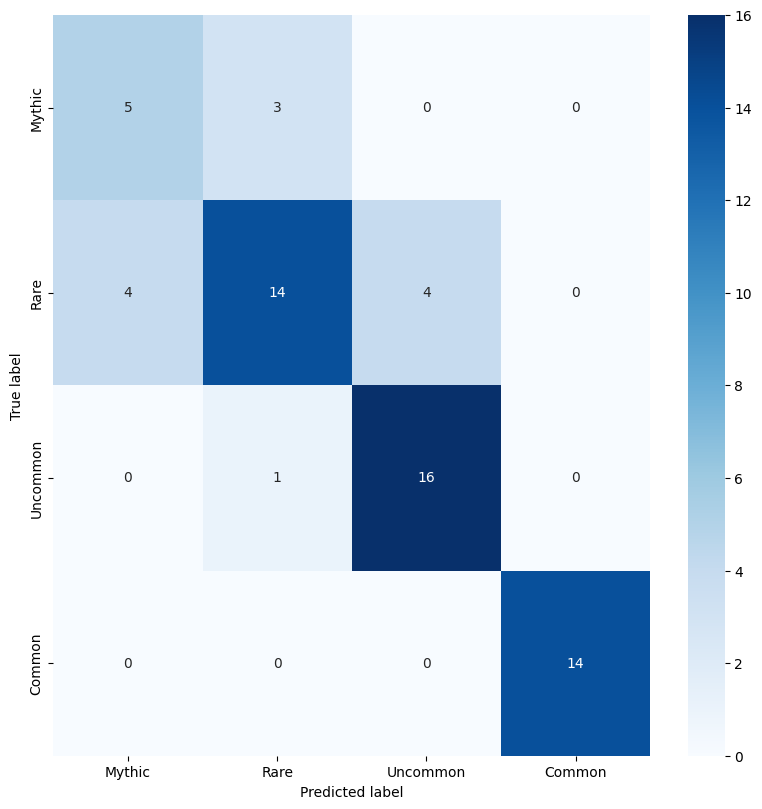

In [26]:
class_names = ['Mythic', 'Rare', 'Uncommon', 'Common']


predictions = model.predict(x=test_set)
predictions = list(map(lambda x: np.argmax(x), predictions))

# Ahora graficamos
plot_confusion_matrix(labels=test_target, predictions=predictions, class_names=class_names)

# 4) Arquitectura #2
Para esta arquitectura haremos lo siguiente:

- Quitar valores nulos
- Aplicar Z-normalization
- Balance de datos (Oversampling, Undersampling)
- Descartar columnas menos dependientes
- Usar tensorcallback, earlystopping y checkpoint
- Función de activación tanh

## 4.1 Extracción de la data

In [586]:
# extracting data por the second architecture

raw_data_arch2 = pd.read_csv("MTG-OTJ-draft-card-ratings-2024-05-25.csv")

raw_data_arch2.head()

,Name,Color,Rarity,# Seen,ALSA,# Picked,ATA,# GP,% GP,GP WR,# OH,OH WR,# GD,GD WR,# GIH,GIH WR,# GNS,GNS WR,IWD
0,Another Round,W,R,64972,6.27,7953,9.59,1690,3.6%,46.6%,259,NaN,402,NaN,661,40.4%,1029,50.6%,-10.2pp
1,Archangel of Tithes,W,M,9905,2.08,3697,2.15,18171,82.7%,53.9%,2952,54.6%,4325,55.8%,7277,55.3%,10927,52.9%,2.4pp
2,Armored Armadillo,W,C,378941,7.89,40803,11.61,31423,12.9%,51.0%,5421,50.0%,7265,50.8%,12686,50.4%,18704,51.3%,-0.9pp
3,Aven Interrupter,W,R,24080,2.42,8609,2.64,44852,86.6%,55.5%,7735,56.6%,10692,57.5%,18427,57.1%,26391,54.3%,2.8pp
4,Bounding Felidar,W,U,98493,4.11,18079,5.53,86683,80.2%,54.6%,13034,53.6%,20093,55.4%,33127,54.7%,52462,54.4%,0.3pp


## 4.2 Encoding data

### 4.2.1 Quitar valores nulos
Al igual que el modelo anterior, hay una gran cantidad de valores nulos dentro del dataset. Si la cantidad de valores eliminados es grande para el tamaño del dataset, es mejor aplicar otras técnicas para rellenar los valores nulos.

In [587]:
""" Valores nulos:
Color       46
ATA          1
GP WR        8
OH WR       31
GD WR       23
GIH WR      16
GNS WR      12
IWD         16
"""



' Valores nulos:\nColor       46\nATA          1\nGP WR        8\nOH WR       31\nGD WR       23\nGIH WR      16\nGNS WR      12\nIWD         16\n'

In [588]:
no_null_dataset_arch2 = raw_data_arch2.copy()

no_null_dataset_arch2 = no_null_dataset_arch2.dropna()

no_null_dataset_arch2.head()


,Name,Color,Rarity,# Seen,ALSA,# Picked,ATA,# GP,% GP,GP WR,# OH,OH WR,# GD,GD WR,# GIH,GIH WR,# GNS,GNS WR,IWD
1,Archangel of Tithes,W,M,9905,2.08,3697,2.15,18171,82.7%,53.9%,2952,54.6%,4325,55.8%,7277,55.3%,10927,52.9%,2.4pp
2,Armored Armadillo,W,C,378941,7.89,40803,11.61,31423,12.9%,51.0%,5421,50.0%,7265,50.8%,12686,50.4%,18704,51.3%,-0.9pp
3,Aven Interrupter,W,R,24080,2.42,8609,2.64,44852,86.6%,55.5%,7735,56.6%,10692,57.5%,18427,57.1%,26391,54.3%,2.8pp
4,Bounding Felidar,W,U,98493,4.11,18079,5.53,86683,80.2%,54.6%,13034,53.6%,20093,55.4%,33127,54.7%,52462,54.4%,0.3pp
5,Bovine Intervention,W,U,136473,6.33,12508,9.99,18372,24.9%,50.7%,2815,46.7%,4488,51.0%,7303,49.4%,11046,51.6%,-2.3pp


###4.2.2 Parseando porcentajes
Reescribiendo las funciones, en este caso esta es la función que convierte un porcentaje de tipo Object a float entre 0 y 1.

In [589]:
def parse_percentage(percentage_string):

  try:
    # Remove the "%" symbol and convert to a float.
    percentage_value = float(percentage_string[:-1])

    # Convert the percentage to a value between 0 and 1.
    return percentage_value / 100


  except (ValueError, IndexError):
    return None


misma función IWD que elimina el texto sobrante ('pp') y lo convierte de un dato tipo Objetct a Float

In [590]:
def parse_IWD(IWD_string):

  try:

    IWD_value = float(IWD_string[:-2])


    return IWD_value

  except (ValueError, IndexError):
    return None


###4.2.3 Rarity - Ordinal Encoding

In [591]:
# M -> Mythic
# R -> Rare
# U -> Uncommon
# C -> Common


def parse_rarity(rarity_string):

  if rarity_string == 'M':
    return 0
  elif rarity_string == 'R':
    return 1
  elif rarity_string == 'U':
    return 2
  elif rarity_string == 'C':
    return 3
  else:
    return None

  return None



###4.2.4 One Hot Encoding - Color

In [592]:
no_null_dataset_arch2 = pd.get_dummies(no_null_dataset_arch2, columns=['Color'])
no_null_dataset_arch2.head()

,Name,Rarity,# Seen,ALSA,# Picked,ATA,# GP,% GP,GP WR,# OH,...,Color_URG,Color_W,Color_WB,Color_WBG,Color_WG,Color_WR,Color_WRG,Color_WU,Color_WUB,Color_WUG
1,Archangel of Tithes,M,9905,2.08,3697,2.15,18171,82.7%,53.9%,2952,...,False,True,False,False,False,False,False,False,False,False
2,Armored Armadillo,C,378941,7.89,40803,11.61,31423,12.9%,51.0%,5421,...,False,True,False,False,False,False,False,False,False,False
3,Aven Interrupter,R,24080,2.42,8609,2.64,44852,86.6%,55.5%,7735,...,False,True,False,False,False,False,False,False,False,False
4,Bounding Felidar,U,98493,4.11,18079,5.53,86683,80.2%,54.6%,13034,...,False,True,False,False,False,False,False,False,False,False
5,Bovine Intervention,U,136473,6.33,12508,9.99,18372,24.9%,50.7%,2815,...,False,True,False,False,False,False,False,False,False,False


In [593]:
one_hot_dataset_arch2 = no_null_dataset_arch2.copy()

In [594]:
def boolean_to_int(value):
  if value == True:
    return 1
  elif value == False:
    return 0
  else:
    return None


In [595]:
#lets create a function that maps (converts) each name of the 'Name' column to an unique id

def name_to_id(name):
  return hash(name) % (10 ** 8)

one_hot_dataset_arch2['Name'] = one_hot_dataset_arch2['Name'].apply(name_to_id)
one_hot_dataset_arch2.head()


,Name,Rarity,# Seen,ALSA,# Picked,ATA,# GP,% GP,GP WR,# OH,...,Color_URG,Color_W,Color_WB,Color_WBG,Color_WG,Color_WR,Color_WRG,Color_WU,Color_WUB,Color_WUG
1,32616683,M,9905,2.08,3697,2.15,18171,82.7%,53.9%,2952,...,False,True,False,False,False,False,False,False,False,False
2,84439568,C,378941,7.89,40803,11.61,31423,12.9%,51.0%,5421,...,False,True,False,False,False,False,False,False,False,False
3,4348619,R,24080,2.42,8609,2.64,44852,86.6%,55.5%,7735,...,False,True,False,False,False,False,False,False,False,False
4,96023458,U,98493,4.11,18079,5.53,86683,80.2%,54.6%,13034,...,False,True,False,False,False,False,False,False,False,False
5,26597395,U,136473,6.33,12508,9.99,18372,24.9%,50.7%,2815,...,False,True,False,False,False,False,False,False,False,False


Ahora aplicamos las funciones creadas a las columnas que requieren ser parseadas a valores numéricos

In [596]:
for column in one_hot_dataset_arch2.columns:
  # función util que indica si el nombre de la columna comienza con Color_
  if column.startswith('Color_'):
    one_hot_dataset_arch2[column] = one_hot_dataset_arch2[column].apply(boolean_to_int)

In [597]:
one_hot_dataset_arch2['Rarity'] = one_hot_dataset_arch2['Rarity'].apply(parse_rarity)
one_hot_dataset_arch2['IWD'] = one_hot_dataset_arch2['IWD'].apply(parse_IWD)


for column in ['% GP', 'GP WR', 'OH WR', 'GD WR', 'GIH WR', 'GNS WR']:
  one_hot_dataset_arch2[column] = one_hot_dataset_arch2[column].apply(parse_percentage)



encoded_dataset = one_hot_dataset_arch2.copy()

In [598]:
encoded_dataset

,Name,Rarity,# Seen,ALSA,# Picked,ATA,# GP,% GP,GP WR,# OH,...,Color_URG,Color_W,Color_WB,Color_WBG,Color_WG,Color_WR,Color_WRG,Color_WU,Color_WUB,Color_WUG
1,32616683,0,9905,2.08,3697,2.15,18171,0.827,0.539,2952,...,0,1,0,0,0,0,0,0,0,0
2,84439568,3,378941,7.89,40803,11.61,31423,0.129,0.510,5421,...,0,1,0,0,0,0,0,0,0,0
3,4348619,1,24080,2.42,8609,2.64,44852,0.866,0.555,7735,...,0,1,0,0,0,0,0,0,0,0
4,96023458,2,98493,4.11,18079,5.53,86683,0.802,0.546,13034,...,0,1,0,0,0,0,0,0,0,0
5,26597395,2,136473,6.33,12508,9.99,18372,0.249,0.507,2815,...,0,1,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
366,58827661,2,116603,5.16,22058,6.77,90483,0.694,0.533,15541,...,0,0,0,0,0,0,0,0,0,0
367,46572485,1,25985,4.34,5123,5.60,21558,0.695,0.553,3678,...,0,0,1,0,0,0,0,0,0,0
368,83367769,1,20820,3.64,6396,4.13,28862,0.776,0.520,4610,...,0,0,0,0,0,0,0,0,0,0
369,67328764,1,34513,5.82,4703,8.59,7301,0.263,0.511,1233,...,0,0,0,0,0,0,0,0,1,0


##4.3 Matriz de correlación

<Axes: >

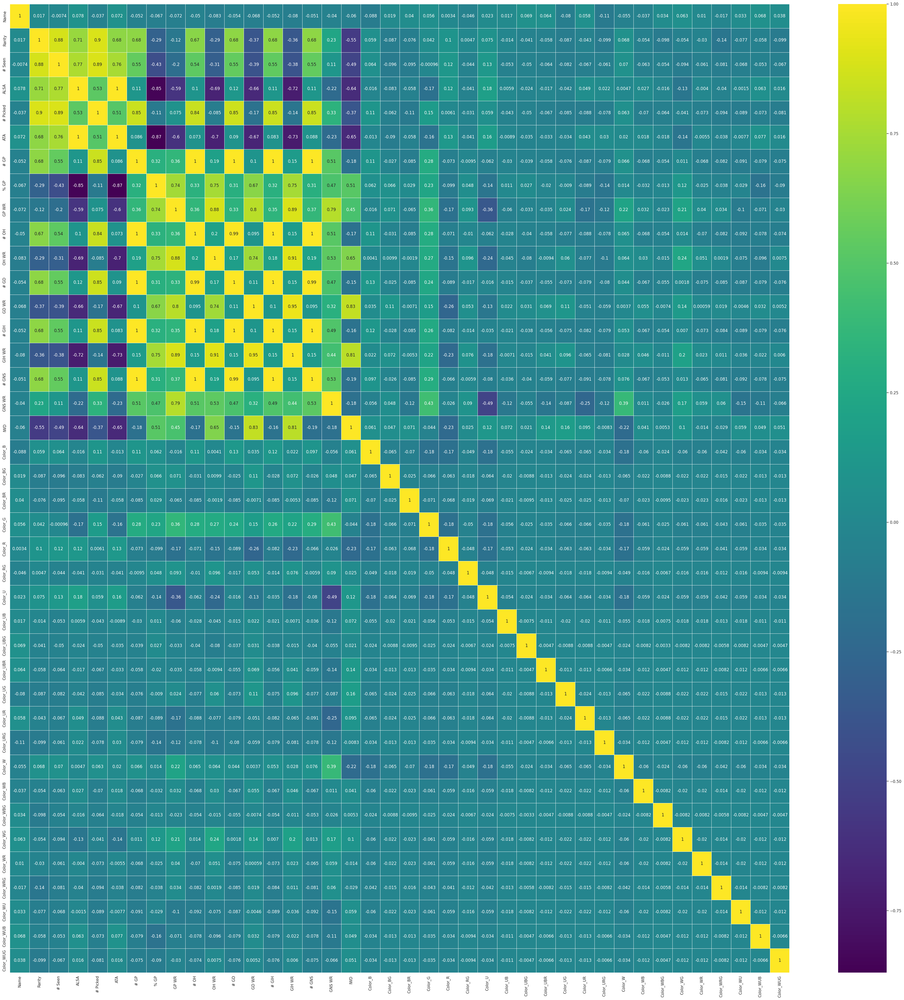

In [599]:
correlation_matrix = encoded_dataset.corr()

# Plotting a heatmap
plt.figure(figsize=(50,50))
sns.heatmap(correlation_matrix, linewidths=.5, cmap='viridis', annot=True)

En base a la matriz, hay algunas columnas que su dependencia con la rareza es muy baja. Estas son:
- Name
- % GP
- GP WR
- OH WR
- GNS WR
- Color

Vamos a eliminar estas columnas para que el modelo pueda entrenar y validar mejor

In [600]:
#vamos a quitar algunas columnas


encoded_dataset.drop(columns=['Name','% GP','GP WR', 'OH WR', 'GNS WR'], inplace=True)

#drop all the columns that begins with 'Color_'
encoded_dataset = encoded_dataset.loc[:, ~encoded_dataset.columns.str.startswith('Color_')]
encoded_dataset.head()

,Rarity,# Seen,ALSA,# Picked,ATA,# GP,# OH,# GD,GD WR,# GIH,GIH WR,# GNS,IWD
1,0,9905,2.08,3697,2.15,18171,2952,4325,0.558,7277,0.553,10927,2.4
2,3,378941,7.89,40803,11.61,31423,5421,7265,0.508,12686,0.504,18704,-0.9
3,1,24080,2.42,8609,2.64,44852,7735,10692,0.575,18427,0.571,26391,2.8
4,2,98493,4.11,18079,5.53,86683,13034,20093,0.554,33127,0.547,52462,0.3
5,2,136473,6.33,12508,9.99,18372,2815,4488,0.510,7303,0.494,11046,-2.3


In [601]:
encoded_dataset

,Rarity,# Seen,ALSA,# Picked,ATA,# GP,# OH,# GD,GD WR,# GIH,GIH WR,# GNS,IWD
1,0,9905,2.08,3697,2.15,18171,2952,4325,0.558,7277,0.553,10927,2.4
2,3,378941,7.89,40803,11.61,31423,5421,7265,0.508,12686,0.504,18704,-0.9
3,1,24080,2.42,8609,2.64,44852,7735,10692,0.575,18427,0.571,26391,2.8
4,2,98493,4.11,18079,5.53,86683,13034,20093,0.554,33127,0.547,52462,0.3
5,2,136473,6.33,12508,9.99,18372,2815,4488,0.510,7303,0.494,11046,-2.3
...,...,...,...,...,...,...,...,...,...,...,...,...,...
366,2,116603,5.16,22058,6.77,90483,15541,25803,0.589,41344,0.571,48695,7.2
367,1,25985,4.34,5123,5.60,21558,3678,5474,0.607,9152,0.588,12360,6.2
368,1,20820,3.64,6396,4.13,28862,4610,7951,0.579,12561,0.541,15870,4.3
369,1,34513,5.82,4703,8.59,7301,1233,2002,0.579,3235,0.547,4034,6.6


##4.4 Normalizacion
Para este segundo modelo, se va a utilizar la Z-Score normalization para evaluar que tan eficiente resulta en comparación con el min-max del modelo anterior

In [602]:
normalized_dataset_arch2 = encoded_dataset.copy()

In [603]:
def z_normalization(column):
    return (column - column.mean()) / column.std()

In [604]:
normalized_dataset_arch2['# Seen'] = z_normalization(normalized_dataset_arch2['# Seen'])
normalized_dataset_arch2['# Picked'] = z_normalization(normalized_dataset_arch2['# Picked'])
normalized_dataset_arch2['# GP'] = z_normalization(normalized_dataset_arch2['# GP'])
normalized_dataset_arch2['# OH'] = z_normalization(normalized_dataset_arch2['# OH'])
normalized_dataset_arch2['# GD'] = z_normalization(normalized_dataset_arch2['# GD'])
normalized_dataset_arch2['# GIH'] = z_normalization(normalized_dataset_arch2['# GIH'])
normalized_dataset_arch2['# GNS'] = z_normalization(normalized_dataset_arch2['# GNS'])



In [605]:
normalized_dataset_arch2

,Rarity,# Seen,ALSA,# Picked,ATA,# GP,# OH,# GD,GD WR,# GIH,GIH WR,# GNS,IWD
1,0,-0.953446,2.08,-1.026450,2.15,-0.809275,-0.808170,-0.832080,0.558,-0.823638,0.553,-0.795991,2.4
2,3,1.997987,7.89,1.065757,11.61,-0.645315,-0.629850,-0.681770,0.508,-0.661430,0.504,-0.631691,-0.9
3,1,-0.840079,2.42,-0.749489,2.64,-0.479165,-0.462725,-0.506562,0.575,-0.489265,0.571,-0.469291,2.8
4,2,-0.244947,4.11,-0.215526,5.53,0.038388,-0.080013,-0.025928,0.554,-0.048432,0.547,0.081496,0.3
5,2,0.058805,6.33,-0.529645,9.99,-0.806788,-0.818064,-0.823746,0.510,-0.822858,0.494,-0.793477,-2.3
...,...,...,...,...,...,...,...,...,...,...,...,...,...
366,2,-0.100109,5.16,0.008828,6.77,0.085403,0.101051,0.266000,0.589,0.197985,0.571,0.001913,7.2
367,1,-0.824843,4.34,-0.946045,5.60,-0.767369,-0.755735,-0.773336,0.607,-0.767409,0.588,-0.765717,6.2
368,1,-0.866151,3.64,-0.874268,4.13,-0.677001,-0.688423,-0.646698,0.579,-0.665178,0.541,-0.691563,4.3
369,1,-0.756639,5.82,-0.969727,8.59,-0.943764,-0.932322,-0.950845,0.579,-0.944852,0.547,-0.941616,6.6


##4.5 Balance de datos
Vamos a hacer un balance de datos aplicando Undersampling y Oversampling. Lo que queremos lograr con esto es que el modelo de inteligencia artificial sepa diferenciar equitativamente los tipos de rareza de las cartas

Class 0 :  45
Class 3 :  75
Class 1 :  73
Class 2 :  110


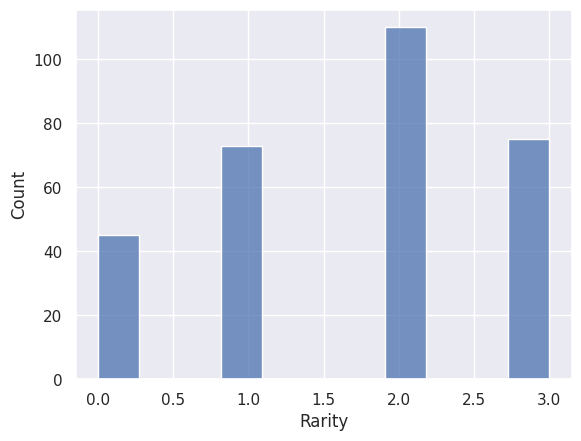

In [606]:
for i in normalized_dataset_arch2["Rarity"].unique():
  numRows = len(normalized_dataset_arch2[normalized_dataset_arch2['Rarity'] == i])
  print("Class", i, ": ", numRows)

# Setting style of the graph
sns.set(style="darkgrid")

# Plotting a histogram
sns.histplot(data=normalized_dataset_arch2, x="Rarity")
plt.show()

In [607]:
values = normalized_dataset_arch2['Rarity'].value_counts()

In [608]:
#lets undersample class 2 to class 1 amount

class_one_count = values[1]

undersampled_class_two = normalized_dataset_arch2[normalized_dataset_arch2['Rarity'] == 2].sample(class_one_count, replace=False)
undersampled_class_three = normalized_dataset_arch2[normalized_dataset_arch2['Rarity'] == 3].sample(class_one_count, replace=False)

#lets oversample class 0 to class 1
oversampled_class_zero = normalized_dataset_arch2[normalized_dataset_arch2['Rarity'] == 0].sample(class_one_count, replace=True)

In [609]:
class_one_dataset = normalized_dataset_arch2[normalized_dataset_arch2['Rarity'] == 1]

balanced_dataset = pd.concat([class_one_dataset, undersampled_class_two, undersampled_class_three, oversampled_class_zero])

balanced_dataset = balanced_dataset.sample(frac=1).reset_index(drop=True)

Class 2 :  73
Class 3 :  73
Class 1 :  73
Class 0 :  73


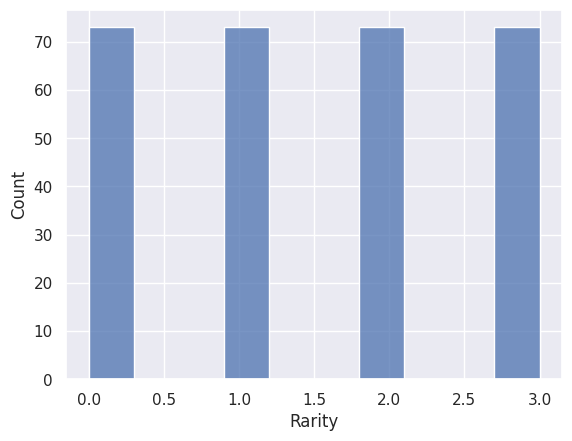

In [610]:
for i in balanced_dataset["Rarity"].unique():
  numRows = len(balanced_dataset[balanced_dataset['Rarity'] == i])
  print("Class", i, ": ", numRows)

# Setting style of the graph
sns.set(style="darkgrid")

# Plotting a histogram
sns.histplot(data=balanced_dataset, x="Rarity")
plt.show()

##4.6 Modelo AI

### 4.3.1 Callback

In [611]:
earlystopping_callback = tf.keras.callbacks.EarlyStopping(monitor='val_loss', min_delta=0.02, patience=4,)

In [612]:
%load_ext tensorboard
%mkdir logs & rm -rf ./logs/


The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
mkdir: cannot create directory ‘logs’: File exists


In [613]:
import datetime


tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir='logs/model/', histogram_freq=1)

In [614]:
checkpoint_path = "training/cp-{epoch:04d}.weights.h5"
checkpoint_dir = os.path.dirname(checkpoint_path)

# Lets create the actual Callback
checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_path,
    monitor='val_loss',
    verbose=1,
    save_best_only=True,
    save_weights_only=True,
    save_freq='epoch'
  )

###4.3.2 Splitting Variables

In [615]:
train, test = train_test_split(balanced_dataset, test_size=0.2)


""" ['Color_B', 'Color_BG', 'Color_BR', 'Color_G',
       'Color_R', 'Color_RG', 'Color_U', 'Color_UB', 'Color_UBG', 'Color_UBR',
       'Color_UG', 'Color_UR', 'Color_URG', 'Color_W', 'Color_WB', 'Color_WBG',
       'Color_WG', 'Color_WR', 'Color_WRG', 'Color_WU', 'Color_WUB',
       'Color_WUG','# Seen', '# Picked', '# GP', '# OH', '# GIH', '# GNS']"""

independent_variables = list(balanced_dataset.columns)
independent_variables.remove('Rarity')
dependent_variables = ['Rarity']

train_set2 = train[independent_variables]
train_target2 = train[dependent_variables]

test_set2 = test[independent_variables]
test_target2 = test[dependent_variables]

**Dentro del dataset, el campo IWD tiene algunos valores negativos, a diferencia de la primera arquitectura, se utilizará la función de activación de TANGENTE INVERSA**

In [616]:
#model
# usando tanh como función de activación
model2 = tf.keras.Sequential([
    tf.keras.layers.InputLayer(input_shape=(len(independent_variables),)),
    tf.keras.layers.Dense(32, activation='tanh'),
    tf.keras.layers.Dense(32, activation='tanh'),
    tf.keras.layers.Dense(32, activation='tanh'),
    tf.keras.layers.Dense(4, activation='softmax')
])


# Compile the Keras model, not the DataFrame
model2.compile(loss=tf.keras.losses.SparseCategoricalCrossentropy(), optimizer='adam', metrics=['accuracy'])

#train!
model2.fit(train_set2, train_target2, epochs=100, batch_size = 128, validation_split=0.2, callbacks=[earlystopping_callback, tensorboard_callback, checkpoint_callback])

Epoch 1/100


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(


2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 403ms/step - accuracy: 0.2633 - loss: 1.3770
Epoch 1: val_loss improved from inf to 1.30621, saving model to training/cp-0001.weights.h5
2/2 ━━━━━━━━━━━━━━━━━━━━ 3s 832ms/step - accuracy: 0.2651 - loss: 1.3798 - val_accuracy: 0.3617 - val_loss: 1.3062
Epoch 2/100
1/2 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - accuracy: 0.4141 - loss: 1.2991
Epoch 2: val_loss improved from 1.30621 to 1.23298, saving model to training/cp-0002.weights.h5
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step - accuracy: 0.4212 - loss: 1.2904 - val_accuracy: 0.4255 - val_loss: 1.2330
Epoch 3/100
1/2 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - accuracy: 0.5469 - loss: 1.1900
Epoch 3: val_loss improved from 1.23298 to 1.17412, saving model to training/cp-0003.weights.h5
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step - accuracy: 0.5228 - loss: 1.1959 - val_accuracy: 0.5532 - val_loss: 1.1741
Epoch 4/100
1/2 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - accuracy: 0.5938 - loss: 1.1473
Epoch 4: val_loss improved from 1.17412 to 1.1

###4.3.3 Evaluation

In [617]:
model2.evaluate(x=test_set2, y=test_target2, batch_size=64)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step - accuracy: 0.9492 - loss: 0.2125


[0.21252089738845825, 0.9491525292396545]

##4.7 Matriz de confusión

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


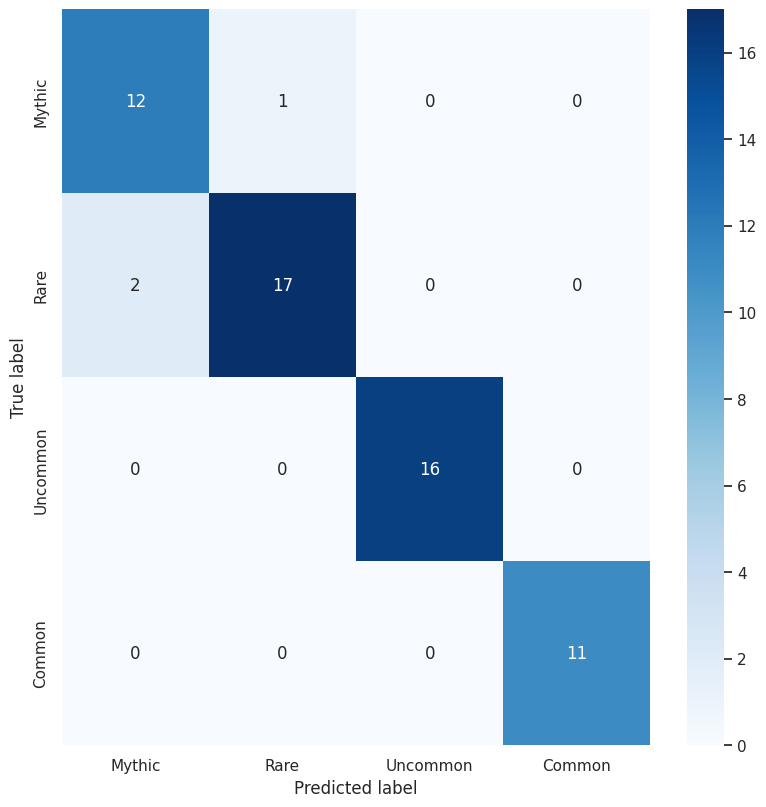

In [618]:
class_names = ['Mythic', 'Rare', 'Uncommon', 'Common']


predictions = model2.predict(x=test_set2)
predictions = list(map(lambda x: np.argmax(x), predictions))

# Ahora graficamos
plot_confusion_matrix(labels=test_target2, predictions=predictions, class_names=class_names)

##4.8 Tensorboard table

In [646]:
%tensorboard --logdir "logs/model/" --port=8000

<IPython.core.display.Javascript object>

#5) Arquitectura #3
Para esta arquitectura haremos lo siguiente:

- Quitar valores nulos.

- Aplicar RobustScaler en lugar de Z-normalization.

- Realizar balance de datos con oversampling.

- Descartar columnas poco relevantes.

- Usar EarlyStopping

- Función de activación ReLU

- Añadir BatchNormalization y Dropout




## 5.1) Extracción de la data

In [647]:
raw_data_arch3 = pd.read_csv("MTG-OTJ-draft-card-ratings-2024-05-25.csv")

raw_data_arch3.head()

,Name,Color,Rarity,# Seen,ALSA,# Picked,ATA,# GP,% GP,GP WR,# OH,OH WR,# GD,GD WR,# GIH,GIH WR,# GNS,GNS WR,IWD
0,Another Round,W,R,64972,6.27,7953,9.59,1690,3.6%,46.6%,259,NaN,402,NaN,661,40.4%,1029,50.6%,-10.2pp
1,Archangel of Tithes,W,M,9905,2.08,3697,2.15,18171,82.7%,53.9%,2952,54.6%,4325,55.8%,7277,55.3%,10927,52.9%,2.4pp
2,Armored Armadillo,W,C,378941,7.89,40803,11.61,31423,12.9%,51.0%,5421,50.0%,7265,50.8%,12686,50.4%,18704,51.3%,-0.9pp
3,Aven Interrupter,W,R,24080,2.42,8609,2.64,44852,86.6%,55.5%,7735,56.6%,10692,57.5%,18427,57.1%,26391,54.3%,2.8pp
4,Bounding Felidar,W,U,98493,4.11,18079,5.53,86683,80.2%,54.6%,13034,53.6%,20093,55.4%,33127,54.7%,52462,54.4%,0.3pp


## 5.2) Encoding data

In [648]:

no_null_dataset_arch3 = raw_data_arch3.copy()

no_null_dataset_arch3 = no_null_dataset_arch3.dropna()

no_null_dataset_arch3.head()


,Name,Color,Rarity,# Seen,ALSA,# Picked,ATA,# GP,% GP,GP WR,# OH,OH WR,# GD,GD WR,# GIH,GIH WR,# GNS,GNS WR,IWD
1,Archangel of Tithes,W,M,9905,2.08,3697,2.15,18171,82.7%,53.9%,2952,54.6%,4325,55.8%,7277,55.3%,10927,52.9%,2.4pp
2,Armored Armadillo,W,C,378941,7.89,40803,11.61,31423,12.9%,51.0%,5421,50.0%,7265,50.8%,12686,50.4%,18704,51.3%,-0.9pp
3,Aven Interrupter,W,R,24080,2.42,8609,2.64,44852,86.6%,55.5%,7735,56.6%,10692,57.5%,18427,57.1%,26391,54.3%,2.8pp
4,Bounding Felidar,W,U,98493,4.11,18079,5.53,86683,80.2%,54.6%,13034,53.6%,20093,55.4%,33127,54.7%,52462,54.4%,0.3pp
5,Bovine Intervention,W,U,136473,6.33,12508,9.99,18372,24.9%,50.7%,2815,46.7%,4488,51.0%,7303,49.4%,11046,51.6%,-2.3pp


### 5.2.1) Parseando porcentajes

In [649]:
def parse_percentage_arch3(percentage_string):
    try:
        percentage_value = float(percentage_string[:-1])
        return percentage_value / 100
    except (ValueError, IndexError):
        return None

### 5.2.2) Ordinal Encoding (Rarity)

In [650]:
one_hot_dataset_arch3 = no_null_dataset_arch3.copy()

In [651]:
# Función para convertir rarezas en valores numéricos
def parse_rarity_arch3(rarity_string):
    if rarity_string == 'M':
        return 0
    elif rarity_string == 'R':
        return 1
    elif rarity_string == 'U':
        return 2
    elif rarity_string == 'C':
        return 3
    else:
        return -1  # Asignamos un valor no válido (fuera del rango de [0, 4)) para evitar None

# Aplicamos el encoding a la columna 'Rarity'
one_hot_dataset_arch3['Rarity'] = one_hot_dataset_arch3['Rarity'].apply(parse_rarity_arch3)

# Filtrar las filas donde 'Rarity' tiene un valor no válido (es decir, -1)
one_hot_dataset_arch3 = one_hot_dataset_arch3[one_hot_dataset_arch3['Rarity'] != -1]

# Asegurarnos de que la columna 'Rarity' sea de tipo entero
one_hot_dataset_arch3['Rarity'] = one_hot_dataset_arch3['Rarity'].astype(int)

# Verifica que no haya valores negativos o NaN
print(one_hot_dataset_arch3['Rarity'].unique())



[0 3 1 2]


### 5.2.3) One Hot Encoding (Color)

In [652]:
# One-hot encoding for 'Color' in architecture 3

one_hot_dataset_arch3 = pd.get_dummies(one_hot_dataset_arch3, columns=['Color'])

one_hot_dataset_arch3.head()

,Name,Rarity,# Seen,ALSA,# Picked,ATA,# GP,% GP,GP WR,# OH,...,Color_URG,Color_W,Color_WB,Color_WBG,Color_WG,Color_WR,Color_WRG,Color_WU,Color_WUB,Color_WUG
1,Archangel of Tithes,0,9905,2.08,3697,2.15,18171,82.7%,53.9%,2952,...,False,True,False,False,False,False,False,False,False,False
2,Armored Armadillo,3,378941,7.89,40803,11.61,31423,12.9%,51.0%,5421,...,False,True,False,False,False,False,False,False,False,False
3,Aven Interrupter,1,24080,2.42,8609,2.64,44852,86.6%,55.5%,7735,...,False,True,False,False,False,False,False,False,False,False
4,Bounding Felidar,2,98493,4.11,18079,5.53,86683,80.2%,54.6%,13034,...,False,True,False,False,False,False,False,False,False,False
5,Bovine Intervention,2,136473,6.33,12508,9.99,18372,24.9%,50.7%,2815,...,False,True,False,False,False,False,False,False,False,False


In [653]:
# Función que convierte valores booleanos a enteros
def boolean_to_int(value):
    if value == True:
        return 1
    elif value == False:
        return 0
    else:
        return None

In [654]:
# Función para convertir 'Name' en un id único
def name_to_id(name):
    return hash(name) % (10 ** 8)

In [655]:
def parse_IWD(IWD_string):

  try:

    IWD_value = float(IWD_string[:-2])


    return IWD_value

  except (ValueError, IndexError):
    return None

In [656]:
# Aplicar la conversión de 'Name' a id único
one_hot_dataset_arch3['Name'] = one_hot_dataset_arch3['Name'].apply(name_to_id)

# Revisamos las primeras filas para ver que todo esté en orden
one_hot_dataset_arch3.head()

,Name,Rarity,# Seen,ALSA,# Picked,ATA,# GP,% GP,GP WR,# OH,...,Color_URG,Color_W,Color_WB,Color_WBG,Color_WG,Color_WR,Color_WRG,Color_WU,Color_WUB,Color_WUG
1,32616683,0,9905,2.08,3697,2.15,18171,82.7%,53.9%,2952,...,False,True,False,False,False,False,False,False,False,False
2,84439568,3,378941,7.89,40803,11.61,31423,12.9%,51.0%,5421,...,False,True,False,False,False,False,False,False,False,False
3,4348619,1,24080,2.42,8609,2.64,44852,86.6%,55.5%,7735,...,False,True,False,False,False,False,False,False,False,False
4,96023458,2,98493,4.11,18079,5.53,86683,80.2%,54.6%,13034,...,False,True,False,False,False,False,False,False,False,False
5,26597395,2,136473,6.33,12508,9.99,18372,24.9%,50.7%,2815,...,False,True,False,False,False,False,False,False,False,False


In [657]:
# Convertir las columnas que empiezan con 'Color_' a enteros (0 o 1)
for column in one_hot_dataset_arch3.columns:
    if column.startswith('Color_'):
        one_hot_dataset_arch3[column] = one_hot_dataset_arch3[column].apply(boolean_to_int)


In [658]:
# Función para parsear porcentajes (es necesario si está en formato '%')
def parse_percentage(percentage_string):
    try:
        percentage_value = float(percentage_string[:-1])
        return percentage_value / 100
    except (ValueError, IndexError):
        return None

In [659]:
# Aplicamos parseo de porcentajes a las columnas correspondientes
for column in ['% GP', 'GP WR', 'OH WR', 'GD WR', 'GIH WR', 'GNS WR']:
    one_hot_dataset_arch3[column] = one_hot_dataset_arch3[column].apply(parse_percentage)

one_hot_dataset_arch3['IWD'] = one_hot_dataset_arch3['IWD'].apply(parse_IWD)

In [660]:
# Copiar el dataset final con todo el encoding aplicado
encoded_dataset_arch3 = one_hot_dataset_arch3.copy()

In [661]:
encoded_dataset_arch3

,Name,Rarity,# Seen,ALSA,# Picked,ATA,# GP,% GP,GP WR,# OH,...,Color_URG,Color_W,Color_WB,Color_WBG,Color_WG,Color_WR,Color_WRG,Color_WU,Color_WUB,Color_WUG
1,32616683,0,9905,2.08,3697,2.15,18171,0.827,0.539,2952,...,0,1,0,0,0,0,0,0,0,0
2,84439568,3,378941,7.89,40803,11.61,31423,0.129,0.510,5421,...,0,1,0,0,0,0,0,0,0,0
3,4348619,1,24080,2.42,8609,2.64,44852,0.866,0.555,7735,...,0,1,0,0,0,0,0,0,0,0
4,96023458,2,98493,4.11,18079,5.53,86683,0.802,0.546,13034,...,0,1,0,0,0,0,0,0,0,0
5,26597395,2,136473,6.33,12508,9.99,18372,0.249,0.507,2815,...,0,1,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
366,58827661,2,116603,5.16,22058,6.77,90483,0.694,0.533,15541,...,0,0,0,0,0,0,0,0,0,0
367,46572485,1,25985,4.34,5123,5.60,21558,0.695,0.553,3678,...,0,0,1,0,0,0,0,0,0,0
368,83367769,1,20820,3.64,6396,4.13,28862,0.776,0.520,4610,...,0,0,0,0,0,0,0,0,0,0
369,67328764,1,34513,5.82,4703,8.59,7301,0.263,0.511,1233,...,0,0,0,0,0,0,0,0,1,0


## 5.3) Matriz de correlación

<Axes: >

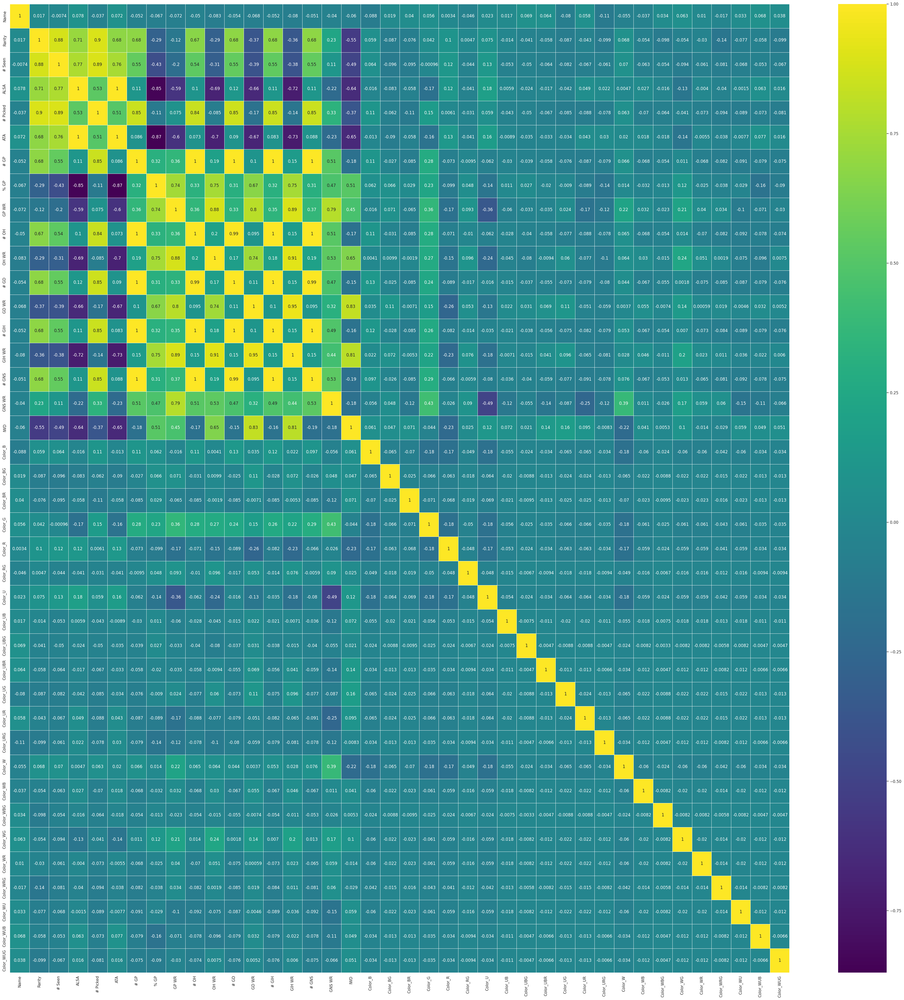

In [662]:
correlation_matrix = encoded_dataset_arch3.corr()

# Plotting a heatmap
plt.figure(figsize=(50,50))
sns.heatmap(correlation_matrix, linewidths=.5, cmap='viridis', annot=True)


In [663]:
#quitar columnas menos relevantes (que ocasionan menos peso)
encoded_dataset_arch3.drop(columns=['Name','% GP','GP WR', 'OH WR', 'GNS WR'], inplace=True)

#drop all the columns that begins with 'Color_'
encoded_dataset_arch3 = encoded_dataset_arch3.loc[:, ~encoded_dataset_arch3.columns.str.startswith('Color_')]
encoded_dataset_arch3.head()

,Rarity,# Seen,ALSA,# Picked,ATA,# GP,# OH,# GD,GD WR,# GIH,GIH WR,# GNS,IWD
1,0,9905,2.08,3697,2.15,18171,2952,4325,0.558,7277,0.553,10927,2.4
2,3,378941,7.89,40803,11.61,31423,5421,7265,0.508,12686,0.504,18704,-0.9
3,1,24080,2.42,8609,2.64,44852,7735,10692,0.575,18427,0.571,26391,2.8
4,2,98493,4.11,18079,5.53,86683,13034,20093,0.554,33127,0.547,52462,0.3
5,2,136473,6.33,12508,9.99,18372,2815,4488,0.510,7303,0.494,11046,-2.3


## 5.4) Normalización

In [664]:
from sklearn.preprocessing import RobustScaler

# Copiar el dataset para la arquitectura 3
scaled_dataset_arch3 = encoded_dataset_arch3.copy()

# Instanciamos el RobustScaler
scaler = RobustScaler()

#% GP', 'GP WR', 'OH WR', 'GD WR', 'GIH WR', 'GNS WR

numeric_columns_arch3 = [col for col in scaled_dataset_arch3.select_dtypes(include=['float64', 'int64']).columns
                         if col != 'Rarity' and col != '% GP' and col != 'GP WR' and col != 'OH WR' and col != 'GD WR' and col !=
                         'GIH WR' and col != 'GNS WR' and col != 'IWD' and not col.startswith('Color_')]

# Aplicamos el RobustScaler a las columnas numéricas continuas
scaled_dataset_arch3[numeric_columns_arch3] = scaler.fit_transform(scaled_dataset_arch3[numeric_columns_arch3])

# Verificamos el resultado
scaled_dataset_arch3.head()


,Rarity,# Seen,ALSA,# Picked,ATA,# GP,# OH,# GD,GD WR,# GIH,GIH WR,# GNS,IWD
1,0,-0.656765,-0.800000,-0.644100,-0.724313,-0.420003,-0.436720,-0.454436,0.558,-0.434439,0.553,-0.434461,2.4
2,3,2.216754,1.275000,1.015159,1.200407,-0.278823,-0.280676,-0.323810,0.508,-0.293955,0.504,-0.286508,-0.9
3,1,-0.546390,-0.678571,-0.424451,-0.624619,-0.135757,-0.134429,-0.171547,0.575,-0.144848,0.571,-0.140267,2.8
4,2,0.033031,-0.075000,-0.000984,-0.036623,0.309889,0.200474,0.246146,0.554,0.236946,0.547,0.355719,0.3
5,2,0.328764,0.717857,-0.250101,0.870804,-0.417862,-0.445378,-0.447194,0.510,-0.433764,0.494,-0.432197,-2.3


## 5.5) Balance de datos

Clase 0 :  45
Clase 3 :  75
Clase 1 :  73
Clase 2 :  110


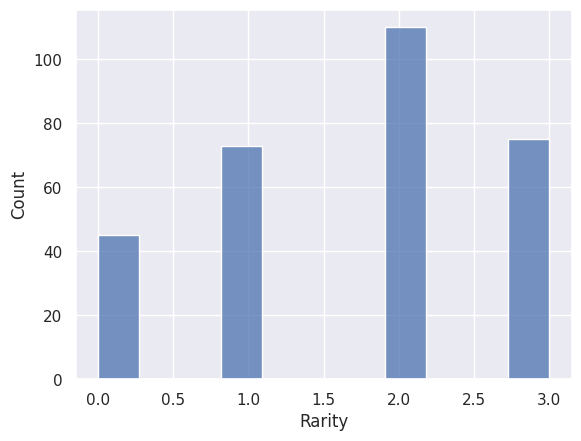

In [665]:
# Verificando la distribución de clases en el dataset original
for i in scaled_dataset_arch3["Rarity"].unique():
  numRows = len(scaled_dataset_arch3[scaled_dataset_arch3['Rarity'] == i])
  print("Clase", i, ": ", numRows)

# Graficando la distribución de clases en un histograma
sns.set(style="darkgrid")
sns.histplot(data=scaled_dataset_arch3, x="Rarity")
plt.show()

In [666]:
balanced_dataset_arch3 = scaled_dataset_arch3.copy()

In [667]:
valores = balanced_dataset_arch3['Rarity'].value_counts()

In [668]:
class_two_count = valores[2]

#aplicando oversampling para clases 0, 1 y 3
oversampled_class_zero = balanced_dataset_arch3[balanced_dataset_arch3['Rarity'] == 0].sample(class_two_count, replace=True)
oversampled_class_one = balanced_dataset_arch3[balanced_dataset_arch3['Rarity'] == 1].sample(class_two_count, replace=True)
oversampled_class_three = balanced_dataset_arch3[balanced_dataset_arch3['Rarity'] == 3].sample(class_two_count, replace=True)



Class 3 :  110
Class 2 :  110
Class 0 :  110
Class 1 :  110


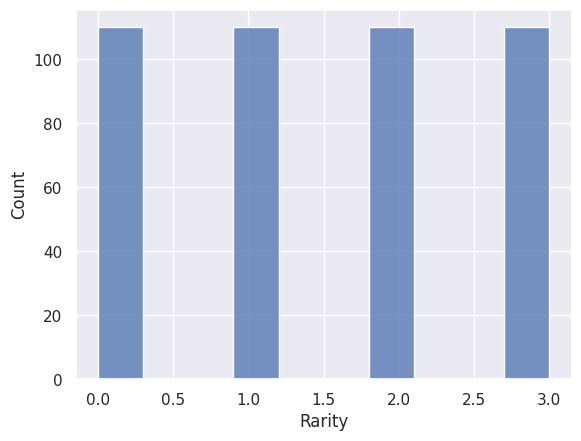

In [669]:
class_two_dataset = balanced_dataset_arch3[balanced_dataset_arch3['Rarity'] == 2]

balanced_dataset_arch3 = pd.concat([class_two_dataset, oversampled_class_zero, oversampled_class_one, oversampled_class_three])

balanced_dataset_arch3 = balanced_dataset_arch3.sample(frac=1).reset_index(drop=True)



for i in balanced_dataset_arch3["Rarity"].unique():
  numRows = len(balanced_dataset_arch3[balanced_dataset_arch3['Rarity'] == i])
  print("Class", i, ": ", numRows)

sns.set(style="darkgrid")

sns.histplot(data=balanced_dataset_arch3, x="Rarity")
plt.show()

## 5.6) Modelo AI

In [670]:
# prompt: create the neural network model based on  balanced_dataset_arch3using 3 callbacks (earlystopping, tensorboard and checkpoint). The dependent variable is 'Rarity'

import tensorflow as tf
import os
import datetime

# Define callbacks
earlystopping_callback = tf.keras.callbacks.EarlyStopping(monitor='val_loss', min_delta=0.02, patience=4)

%load_ext tensorboard
!mkdir -p logs
log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir='logs/model/', histogram_freq=1)

checkpoint_path = "training_arch3/cp-{epoch:04d}.weights.h5"
checkpoint_dir = os.path.dirname(checkpoint_path)
checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_path,
    monitor='val_loss',
    verbose=1,
    save_best_only=True,
    save_weights_only=True,
    save_freq='epoch'
)



independent_variables = list(balanced_dataset_arch3.columns)
independent_variables.remove('Rarity')
dependent_variables = ['Rarity']

train, test = train_test_split(balanced_dataset_arch3, test_size=0.2)

train_set3 = train[independent_variables]
train_target3 = train[dependent_variables]

test_set3 = test[independent_variables]
test_target3 = test[dependent_variables]

# Model architecture
model3 = tf.keras.Sequential([
    tf.keras.layers.InputLayer(input_shape=(len(independent_variables),)),
    tf.keras.layers.Dense(64, activation='relu'),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Dropout(0.3),
    tf.keras.layers.Dense(64, activation='relu'),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Dropout(0.3),
    tf.keras.layers.Dense(4, activation='softmax')
])

model3.compile(loss=tf.keras.losses.SparseCategoricalCrossentropy(), optimizer='adam', metrics=['accuracy'])

# Training the model
model3.fit(train_set3, train_target3, epochs=50, batch_size=128,
          validation_split=0.2, callbacks=[earlystopping_callback, tensorboard_callback, checkpoint_callback])




The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/50


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(


3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - accuracy: 0.4566 - loss: 1.5109
Epoch 1: val_loss improved from inf to 1.21743, saving model to training_arch3/cp-0001.weights.h5
3/3 ━━━━━━━━━━━━━━━━━━━━ 6s 1s/step - accuracy: 0.4555 - loss: 1.5040 - val_accuracy: 0.4930 - val_loss: 1.2174
Epoch 2/50
1/3 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - accuracy: 0.5625 - loss: 1.1276
Epoch 2: val_loss improved from 1.21743 to 1.17764, saving model to training_arch3/cp-0002.weights.h5
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step - accuracy: 0.5331 - loss: 1.2109 - val_accuracy: 0.5070 - val_loss: 1.1776
Epoch 3/50
1/3 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - accuracy: 0.5234 - loss: 1.1941
Epoch 3: val_loss improved from 1.17764 to 1.14169, saving model to training_arch3/cp-0003.weights.h5
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step - accuracy: 0.5725 - loss: 1.1036 - val_accuracy: 0.5070 - val_loss: 1.1417
Epoch 4/50
1/3 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step - accuracy: 0.5703 - loss: 0.9677
Epoch 4: val_loss improved from 1.1416

In [671]:
# Evaluar
model3.evaluate(x=test_set3, y=test_target3, batch_size=64)

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step - accuracy: 0.8826 - loss: 0.3810


[0.3757341504096985, 0.8863636255264282]

### 5.6.1) Evaluación del modelo

# 5.7) Matriz de confusión

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


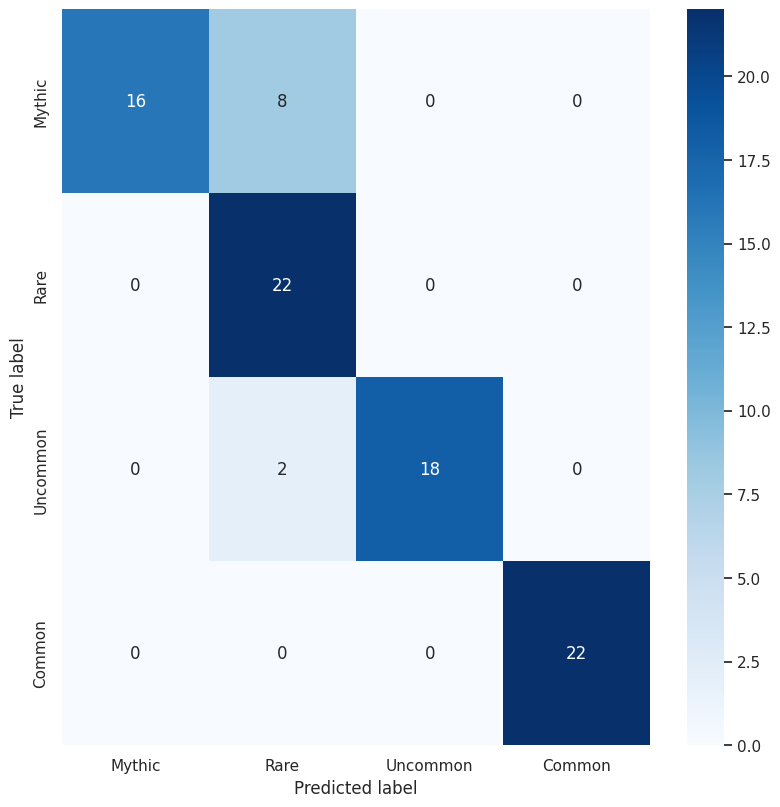

In [672]:
class_names = ['Mythic', 'Rare', 'Uncommon', 'Common']


predictions = model3.predict(x=test_set3)
predictions = list(map(lambda x: np.argmax(x), predictions))

# Ahora graficamos
plot_confusion_matrix(labels=test_target3, predictions=predictions, class_names=class_names)

##5.8) Tensorboard table

In [673]:
%tensorboard --logdir "logs/model/" --port=9000

<IPython.core.display.Javascript object>